In [1]:
!pip install rasterio geopandas osmnx overturemaps pyarrow -q
print("✅ Bibliothèques installées.")

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 37.6/37.6 MB 51.1 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 101.5/101.5 kB 8.2 MB/s eta 0:00:00
✅ Bibliothèques installées.


In [2]:
import os
import glob
import numpy as np
import matplotlib.pyplot as plt

import rasterio
from rasterio.features import rasterize
from rasterio import features

import geopandas as gpd
from shapely.geometry import box, shape
from pyproj import Transformer, CRS

import cv2
from scipy import ndimage as ndi
from skimage.feature import peak_local_max
from skimage.segmentation import watershed
from skimage.morphology import remove_small_objects, remove_small_holes

import tensorflow as tf
from tensorflow.keras import layers, Model

# -----------------------------
# KAGGLE CONFIGURATION
# -----------------------------
# 1. Update this to match your Kaggle dataset folder name
KAGGLE_DATASET_PATH = "/kaggle/input/images" 

# Automatically find all .tif files in the input directories
all_tif_files = glob.glob(os.path.join(KAGGLE_DATASET_PATH, "**/*.tif"), recursive=True)

OUTPUT_DIR = "/kaggle/working/outputs"
os.makedirs(OUTPUT_DIR, exist_ok=True)

# Bands to use (1-based indexing). Sentinel-2 RGB is typically [1, 2, 3] in your SR output.
BANDS = None                   

# Download footprints settings
BUFFER_DEG = 0.005             
FOOTPRINT_SOURCE = "osm"      # Setting to 'osm' for stability on Kaggle

# Mask settings
RASTERIZE_ALL_TOUCHED = False  
LABEL_DILATE_PIXELS = 0        

# Training settings (Optimized for 25 images)
PATCH_SIZE = 256
N_PATCHES_PER_IMAGE = 60       # 60 * 25 images = 1500 total patches
POS_FRACTION = 0.6             
MIN_POS_RATIO = 0.01           
MAX_NEG_RATIO = 0.001          

BATCH_SIZE = 16                # Increased for GPU efficiency on Kaggle
EPOCHS = 40
LR = 1e-4
SEED = 42

# Inference settings
TILE_SIZE = PATCH_SIZE
STRIDE = PATCH_SIZE // 2       
PRED_THRESHOLD = 0.5           

# Postprocess
MIN_OBJECT_PIXELS = 40
HOLE_PIXELS = 80
USE_WATERSHED_SPLIT = True     
WATERSHED_MIN_DISTANCE = 6     

# Model save
MODEL_PATH = os.path.join(OUTPUT_DIR, "unet_buildings.keras")

np.random.seed(SEED)
tf.random.set_seed(SEED)

print(f"✅ Config loaded for Kaggle")
print(f"📂 Found {len(all_tif_files)} .tif files")
if len(all_tif_files) > 0:
    print(f"🖼️ Sample image path: {all_tif_files[0]}")
else:
    print("❌ WARNING: No .tif files found. Check your KAGGLE_DATASET_PATH.")

# Check for GPU (Highly recommended for Kaggle)
device_name = tf.test.gpu_device_name()
if device_name:
    print(f"🚀 GPU Found: {device_name}")
else:
    print("⚠️ No GPU found. Training will be VERY slow. Enable GPU in Kaggle settings (Right Sidebar).")

2026-01-05 18:01:16.439702: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:467] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1767636076.604305      55 cuda_dnn.cc:8579] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1767636076.649739      55 cuda_blas.cc:1407] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
W0000 00:00:1767636077.025925      55 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking the same target more than once.
W0000 00:00:1767636077.025960      55 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking the same target more than once.
W0000 00:00:1767636077.025963      55 computation_placer.cc:177] computation placer alr

✅ Config loaded for Kaggle
📂 Found 17 .tif files
🖼️ Sample image path: /kaggle/input/images/sr8.tif
🚀 GPU Found: /device:GPU:0


I0000 00:00:1767636088.376908      55 gpu_device.cc:2019] Created device /device:GPU:0 with 13942 MB memory:  -> device: 0, name: Tesla T4, pci bus id: 0000:00:04.0, compute capability: 7.5
I0000 00:00:1767636088.380888      55 gpu_device.cc:2019] Created device /device:GPU:1 with 13942 MB memory:  -> device: 1, name: Tesla T4, pci bus id: 0000:00:05.0, compute capability: 7.5


🧐 Visualizing 3 test images from the dataset...
✅ Image 1 loaded: sr8.tif | Shape: (512, 512, 3) | CRS: EPSG:32636
✅ Image 2 loaded: sr7.tif | Shape: (512, 512, 3) | CRS: EPSG:32632
✅ Image 3 loaded: sr3.tif | Shape: (512, 512, 3) | CRS: EPSG:32631


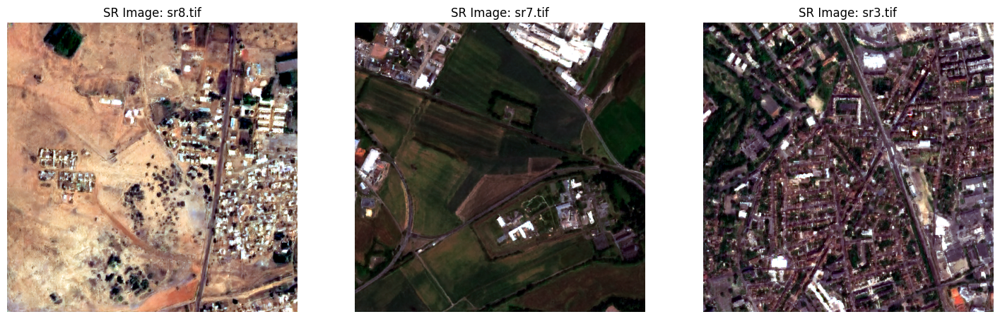

In [3]:
def percentile_normalize(img, pmin=2, pmax=98, eps=1e-6):
    """
    Robust per-band normalization to [0,1] using percentiles.
    Works for uint8, uint16, float, Sentinel-style ranges, etc.
    img: (H,W,C)
    """
    img = img.astype(np.float32)
    out = np.zeros_like(img, dtype=np.float32)
    for c in range(img.shape[2]):
        band = img[..., c]
        lo = np.percentile(band, pmin)
        hi = np.percentile(band, pmax)
        if hi - lo < eps:
            out[..., c] = 0.0
        else:
            out[..., c] = (band - lo) / (hi - lo)
    return np.clip(out, 0, 1)


def load_geotiff_rgb(path, bands=None):
    """
    Load a GeoTIFF and return:
      img (H,W,3) float32 in [0,1],
      profile, crs, transform, bounds
    """
    with rasterio.open(path) as src:
        profile = src.profile.copy()
        crs = src.crs
        transform = src.transform
        bounds = src.bounds

        if bands is None:
            # use first 3 available, or replicate if fewer
            use = list(range(1, min(3, src.count) + 1))
        else:
            use = bands

        arr = np.stack([src.read(b) for b in use], axis=-1)  # (H,W,C)

    # If <3 bands -> replicate to 3
    if arr.shape[2] == 1:
        arr = np.repeat(arr, 3, axis=2)
    elif arr.shape[2] == 2:
        arr = np.concatenate([arr, arr[..., :1]], axis=2)

    img = percentile_normalize(arr)[:, :, :3]
    return img, profile, crs, transform, bounds

# --- KAGGLE ADAPTATION: Test the loading on the first few images ---
num_to_show = min(3, len(all_tif_files))
print(f"🧐 Visualizing {num_to_show} test images from the dataset...")

plt.figure(figsize=(18, 6))
for i in range(num_to_show):
    test_path = all_tif_files[i]
    img, profile, crs, transform, bounds = load_geotiff_rgb(test_path, BANDS)
    
    print(f"✅ Image {i+1} loaded: {os.path.basename(test_path)} | Shape: {img.shape} | CRS: {crs}")
    
    plt.subplot(1, num_to_show, i+1)
    plt.imshow(img)
    plt.title(f"SR Image: {os.path.basename(test_path)}")
    plt.axis("off")

plt.show()

In [4]:
import os
import geopandas as gpd
from shapely.geometry import box
from pyproj import Transformer
import osmnx as ox

# Create a subdirectory for footprint caches to keep things organized
CACHE_DIR = os.path.join(OUTPUT_DIR, "footprint_cache")
os.makedirs(CACHE_DIR, exist_ok=True)

def bounds_to_wgs84(bounds, src_crs):
    to_wgs84 = Transformer.from_crs(src_crs, "EPSG:4326", always_xy=True)
    lon_min, lat_min = to_wgs84.transform(bounds.left, bounds.bottom)
    lon_max, lat_max = to_wgs84.transform(bounds.right, bounds.top)
    west, east = min(lon_min, lon_max), max(lon_min, lon_max)
    south, north = min(lat_min, lat_max), max(lat_min, lat_max)
    return west, south, east, north

def download_buildings(bounds, src_crs, buffer_deg=0.005, source="auto"):
    """
    Returns GeoDataFrame in src_crs with Polygon/MultiPolygon buildings clipped to image bounds.
    """
    west, south, east, north = bounds_to_wgs84(bounds, src_crs)
    bbox_wgs = (west-buffer_deg, south-buffer_deg, east+buffer_deg, north+buffer_deg)
    print(f"   🌍 Downloading buildings for WGS84 bbox: {bbox_wgs}")

    img_poly_src = box(bounds.left, bounds.bottom, bounds.right, bounds.top)
    gdf = None

    # 1) Overture (Best for high-quality rooftops if available)
    if source in ("auto", "overture"):
        try:
            import overturemaps
            print("   🏢 Trying Overture Maps...")
            reader = overturemaps.record_batch_reader("building", bbox=bbox_wgs)
            table = reader.read_all()
            gdf = gpd.GeoDataFrame.from_arrow(table)

            if gdf.crs is None:
                gdf = gdf.set_crs("EPSG:4326")

            gdf = gdf.to_crs(src_crs)
            gdf = gdf[gdf.geometry.notnull() & gdf.geometry.is_valid]
            gdf = gdf[gdf.geometry.geom_type.isin(["Polygon","MultiPolygon"])]
            gdf = gdf[gdf.intersects(img_poly_src)]

            if len(gdf) == 0: gdf = None
            else: print(f"   ✅ Overture buildings found: {len(gdf)}")
        except Exception as e:
            print("   ⚠️ Overture failed or not installed, falling back to OSM...")
            gdf = None

    # 2) OSM fallback (Very reliable globally)
    if gdf is None and source in ("auto", "osm"):
        try:
            print("   🧭 Trying OpenStreetMap (osmnx)...")
            bbox_poly = box(bbox_wgs[0], bbox_wgs[1], bbox_wgs[2], bbox_wgs[3])
            tags = {"building": True}
            gdf = ox.features_from_polygon(bbox_poly, tags=tags)
            gdf = gdf.to_crs(src_crs)
            gdf = gdf[gdf.geometry.notnull() & gdf.geometry.is_valid]
            gdf = gdf[gdf.geometry.geom_type.isin(["Polygon","MultiPolygon"])]
            gdf = gdf[gdf.intersects(img_poly_src)]
            print(f"   ✅ OSM buildings found: {len(gdf)}")
        except Exception as e:
            print("   ❌ OSM failed:", e)
            gdf = gpd.GeoDataFrame({"geometry": []}, crs=src_crs)

    if gdf is None:
        gdf = gpd.GeoDataFrame({"geometry": []}, crs=src_crs)

    return gdf

# --- KAGGLE ADAPTATION: Demonstrate footprint retrieval for the first image ---
first_img_path = all_tif_files[0]
img_name = os.path.basename(first_img_path).replace(".tif", "")
cache_path = os.path.join(CACHE_DIR, f"{img_name}_footprints.geojson")

# Get metadata from Cell 2 variables (assumes last loaded)
if os.path.exists(cache_path):
    footprints = gpd.read_file(cache_path).to_crs(crs)
    print(f"✅ Loaded cached footprints for {img_name}: {len(footprints)} buildings")
else:
    footprints = download_buildings(bounds, crs, buffer_deg=BUFFER_DEG, source=FOOTPRINT_SOURCE)
    if len(footprints) > 0:
        footprints.to_file(cache_path, driver="GeoJSON")
        print(f"✅ Saved footprints cache to: {cache_path}")

footprints.head()

   🌍 Downloading buildings for WGS84 bbox: (2.3863549453756856, 48.789197234404426, 2.4136470490784365, 48.810802119191344)
   🧭 Trying OpenStreetMap (osmnx)...
   ✅ OSM buildings found: 3562
✅ Saved footprints cache to: /kaggle/working/outputs/footprint_cache/sr8_footprints.geojson


geometry addr:city  \
element  id                                                                     
relation 1190230  POLYGON ((455691.368 5405787.515, 455695.047 5...       NaN   
         1190257  POLYGON ((455496.925 5405872.636, 455497.758 5...       NaN   
         1878288  POLYGON ((456215.337 5404963.539, 456217.42 54...       NaN   
         1878292  POLYGON ((456011.679 5405356.224, 456006.315 5...       NaN   
         1878293  POLYGON ((455882.811 5405423.718, 455881.782 5...       NaN   

                 addr:housenumber addr:postcode addr:street building name  \
element  id                                                                 
relation 1190230              NaN           NaN         NaN      yes  NaN   
         1190257              NaN           NaN         NaN      yes  NaN   
         1878288              NaN           NaN         NaN      yes  NaN   
         1878292              NaN           NaN         NaN      yes  NaN   
         1878293              NaN           NaN         NaN      yes  NaN   

                 description  \
element  id                    
relation 1190230         NaN   
         1190257         NaN   
         1878288         NaN   
         1878292         NaN   
         1878293         NaN   

                                                             source  \
element  id                                                           
relation 1190230  extraction vectorielle v1 cadastre-dgi-fr sour...   
         1190257  extraction vectorielle v1 cadastre-dgi-fr sour...   
         1878288                                                NaN   
         1878292                                                NaN   
         1878293                                                NaN   

                 building:levels  ... short_name barrier ref:FR:RTE  \
element  id                       ...                                 
relation 1190230             NaN  ...        NaN     NaN        NaN   
         1190257             NaN  ...        NaN     NaN        NaN   
         1878288             NaN  ...        NaN     NaN        NaN   
         1878292             NaN  ...        NaN     NaN        NaN   
         1878293             NaN  ...        NaN     NaN        NaN   

                 ref:FR:RTE_nom source:date microbrewery min_age  \
element  id                                                        
relation 1190230            NaN         NaN          NaN     NaN   
         1190257            NaN         NaN          NaN     NaN   
         1878288            NaN         NaN          NaN     NaN   
         1878292            NaN         NaN          NaN     NaN   
         1878293            NaN         NaN          NaN     NaN   

                          type addr:housename surface  
element  id                                            
relation 1190230  multipolygon            NaN     NaN  
         1190257  multipolygon            NaN     NaN  
         1878288  multipolygon            NaN     NaN  
         1878292  multipolygon            NaN     NaN  
         1878293  multipolygon            NaN     NaN  

[5 rows x 120 columns]

🚀 Starting dataset creation for 17 images...
🔄 Processing [1/17]: sr8.tif
   ⚠️ Skipped: No buildings found in this image area.
🔄 Processing [2/17]: sr7.tif
   🌍 Downloading buildings for WGS84 bbox: (7.418826474903768, 50.41528178336645, 7.446459957181595, 50.437031710712816)
   🧭 Trying OpenStreetMap (osmnx)...
   ✅ OSM buildings found: 118
   ✅ Done. Coverage: 6.24%
🔄 Processing [3/17]: sr3.tif
   🌍 Downloading buildings for WGS84 bbox: (2.3863549453756856, 48.789197234404426, 2.4136470490784365, 48.810802119191344)
   🧭 Trying OpenStreetMap (osmnx)...
   ✅ OSM buildings found: 3562
   ✅ Done. Coverage: 24.28%
🔄 Processing [4/17]: sr4.tif
   🌍 Downloading buildings for WGS84 bbox: (2.3861430110540764, 49.98919760929101, 2.413859120943255, 50.010801716448015)
   🧭 Trying OpenStreetMap (osmnx)...
   ✅ OSM buildings found: 191
   ✅ Done. Coverage: 1.13%
🔄 Processing [5/17]: sr10.tif
   🌍 Downloading buildings for WGS84 bbox: (32.27781858077766, 2.756139012734858, 32.29932715771741, 2.7

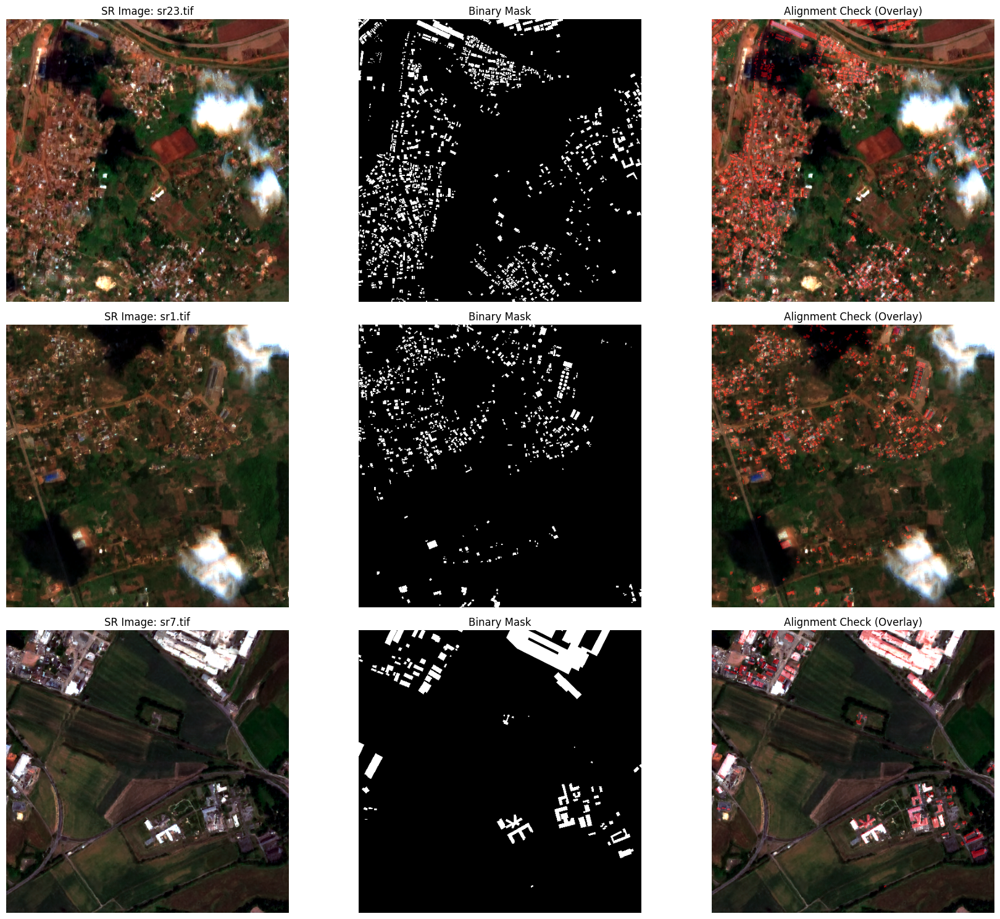

In [5]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from rasterio.features import rasterize

def rasterize_buildings(footprints_gdf, out_shape, transform, all_touched=False):
    """
    Converts building polygons into a binary numpy array (mask).
    """
    if len(footprints_gdf) == 0:
        return np.zeros(out_shape, dtype=np.uint8)

    shapes_ = [(geom, 1) for geom in footprints_gdf.geometry]
    mask = rasterize(
        shapes=shapes_,
        out_shape=out_shape,
        transform=transform,
        fill=0,
        dtype=np.uint8,
        all_touched=all_touched
    )
    return mask

# --- KAGGLE ADAPTATION: THE MULTI-IMAGE LOOP ---
# These lists will store the full-size data before we cut them into patches
images_list = []
masks_list = []
file_metadata = []

print(f"🚀 Starting dataset creation for {len(all_tif_files)} images...")

for i, f_path in enumerate(all_tif_files):
    img_name = os.path.basename(f_path)
    print(f"🔄 Processing [{i+1}/{len(all_tif_files)}]: {img_name}")
    
    try:
        # 1. Load Image
        img_data, prof, crs, trans, bnds = load_geotiff_rgb(f_path, BANDS)
        
        # 2. Get Buildings (using the unique cache from Cell 3)
        cache_path = os.path.join(CACHE_DIR, f"{img_name.replace('.tif', '')}_footprints.geojson")
        
        if os.path.exists(cache_path):
            footprints_gdf = gpd.read_file(cache_path).to_crs(crs)
        else:
            footprints_gdf = download_buildings(bnds, crs, buffer_deg=BUFFER_DEG, source=FOOTPRINT_SOURCE)
            if len(footprints_gdf) > 0:
                footprints_gdf.to_file(cache_path, driver="GeoJSON")

        # 3. Create Mask
        H, W = img_data.shape[:2]
        mask_data = rasterize_buildings(footprints_gdf, (H, W), trans, all_touched=RASTERIZE_ALL_TOUCHED)

        # 4. Optional Dilation (if specified in config)
        if LABEL_DILATE_PIXELS > 0:
            k = 2*LABEL_DILATE_PIXELS + 1
            kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (k, k))
            mask_data = cv2.dilate(mask_data, kernel, iterations=1)

        # 5. Store if not empty
        if mask_data.sum() > 0:
            images_list.append(img_data)
            masks_list.append(mask_data)
            file_metadata.append({"name": img_name, "transform": trans, "crs": crs})
            coverage = 100.0 * mask_data.mean()
            print(f"   ✅ Done. Coverage: {coverage:.2f}%")
        else:
            print(f"   ⚠️ Skipped: No buildings found in this image area.")

    except Exception as e:
        print(f"   ❌ Error processing {img_name}: {e}")

print(f"\n🏁 Finished! Created {len(images_list)} Image/Mask pairs.")

# --- VISUALIZATION OF 3 RANDOM PAIRS ---
num_samples = min(3, len(images_list))
if num_samples > 0:
    fig, axes = plt.subplots(num_samples, 3, figsize=(18, 5 * num_samples))
    indices = np.random.choice(len(images_list), num_samples, replace=False)
    
    for i, idx in enumerate(indices):
        curr_img = images_list[idx]
        curr_mask = masks_list[idx]
        
        # Subplot 1: Original Image
        axes[i, 0].imshow(curr_img)
        axes[i, 0].set_title(f"SR Image: {file_metadata[idx]['name']}")
        axes[i, 0].axis("off")
        
        # Subplot 2: Binary Mask
        axes[i, 1].imshow(curr_mask, cmap="gray")
        axes[i, 1].set_title("Binary Mask")
        axes[i, 1].axis("off")
        
        # Subplot 3: Overlay
        overlay = curr_img.copy()
        overlay[curr_mask > 0, 0] = np.clip(overlay[curr_mask > 0, 0] + 0.4, 0, 1) # Highlight buildings in red
        axes[i, 2].imshow(overlay)
        axes[i, 2].set_title("Alignment Check (Overlay)")
        axes[i, 2].axis("off")
        
    plt.tight_layout()
    plt.show()

🚜 Extracting ~333 patches from each of the 15 images...
✅ Total dataset size: 3521 patches.
📊 Training patches: 2816
📊 Validation patches: 705


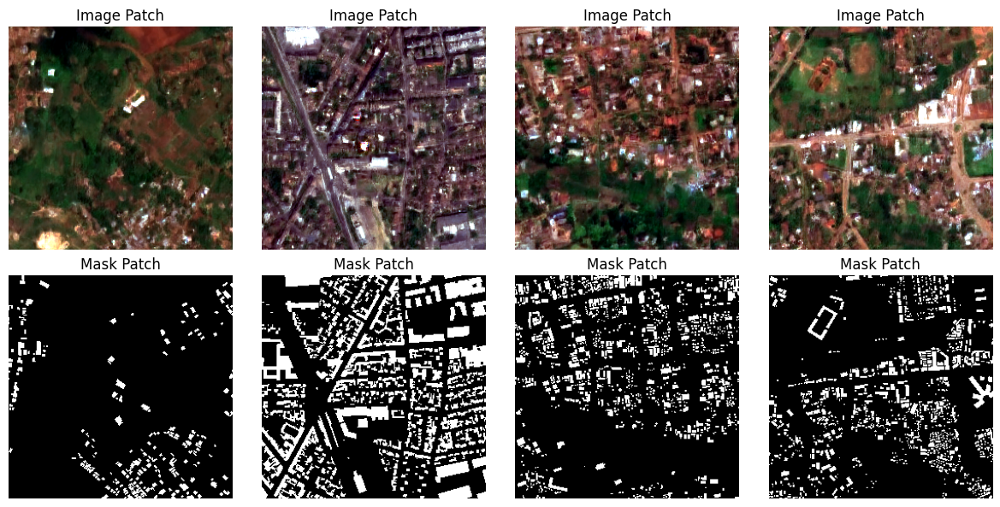

In [6]:
def sample_patches_balanced(img, mask, patch_size, n_patches,
                            pos_fraction=0.6,
                            min_pos_ratio=0.01,
                            max_neg_ratio=0.001,
                            max_tries=200000,
                            seed=42):
    """
    Balanced patch sampling logic (Your original function).
    """
    rng = np.random.default_rng(seed)
    H, W = mask.shape
    ps = patch_size

    if H < ps or W < ps:
        return np.array([]), np.array([])

    ys, xs = np.where(mask > 0)
    has_pos = len(xs) > 0

    X, Y = [], []
    n_pos = int(n_patches * pos_fraction)
    n_neg = n_patches - n_pos

    def clip_xy(cx, cy):
        x0 = int(np.clip(cx - ps//2, 0, W-ps))
        y0 = int(np.clip(cy - ps//2, 0, H-ps))
        return x0, y0

    tries = 0
    # Positive patches
    while len(X) < n_pos and tries < max_tries:
        tries += 1
        if not has_pos: break
        i = rng.integers(0, len(xs))
        cx, cy = xs[i], ys[i]
        x0, y0 = clip_xy(cx, cy)
        pm = mask[y0:y0+ps, x0:x0+ps]
        if pm.mean() >= min_pos_ratio:
            X.append(img[y0:y0+ps, x0:x0+ps])
            Y.append(pm[..., None])

    # Negative patches
    tries = 0
    while len(X) < n_pos + n_neg and tries < max_tries:
        tries += 1
        x0 = rng.integers(0, W-ps+1)
        y0 = rng.integers(0, H-ps+1)
        pm = mask[y0:y0+ps, x0:x0+ps]
        if pm.mean() <= max_neg_ratio:
            X.append(img[y0:y0+ps, x0:x0+ps])
            Y.append(pm[..., None])

    return np.asarray(X, dtype=np.float32), np.asarray(Y, dtype=np.float32)

# --- KAGGLE MULTI-IMAGE ADAPTATION ---
X_all_patches = []
Y_all_patches = []
N_PATCHES=5000
# Distribute the total requested patches across all available images
patches_per_image = N_PATCHES // len(images_list)

print(f"🚜 Extracting ~{patches_per_image} patches from each of the {len(images_list)} images...")

for i in range(len(images_list)):
    xp, yp = sample_patches_balanced(
        images_list[i], masks_list[i],
        patch_size=PATCH_SIZE,
        n_patches=patches_per_image,
        pos_fraction=POS_FRACTION,
        min_pos_ratio=MIN_POS_RATIO,
        max_neg_ratio=MAX_NEG_RATIO,
        seed=SEED + i # Vary seed per image
    )
    if len(xp) > 0:
        X_all_patches.append(xp)
        Y_all_patches.append(yp)

# Combine everything into final arrays
X = np.concatenate(X_all_patches, axis=0)
Y = np.concatenate(Y_all_patches, axis=0)

print(f"✅ Total dataset size: {len(X)} patches.")

# --- Train/Val Split ---
idx = np.arange(len(X))
np.random.seed(SEED)
np.random.shuffle(idx)
split = int(0.8 * len(X))
train_idx, val_idx = idx[:split], idx[split:]

X_train, Y_train = X[train_idx], Y[train_idx]
X_val, Y_val = X[val_idx], Y[val_idx]

print(f"📊 Training patches: {X_train.shape[0]}")
print(f"📊 Validation patches: {X_val.shape[0]}")

# --- Sanity Plot ---
plt.figure(figsize=(12, 6))
for i in range(4):
    j = np.random.randint(0, len(X_train))
    plt.subplot(2, 4, i+1)
    plt.imshow(X_train[j])
    plt.axis("off")
    plt.title("Image Patch")
    
    plt.subplot(2, 4, 4 + i + 1)
    plt.imshow(Y_train[j].squeeze(), cmap="gray")
    plt.axis("off")
    plt.title("Mask Patch")
plt.tight_layout()
plt.show()

I0000 00:00:1767640397.002246      55 gpu_device.cc:2019] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 13942 MB memory:  -> device: 0, name: Tesla T4, pci bus id: 0000:00:04.0, compute capability: 7.5
I0000 00:00:1767640397.002474      55 gpu_device.cc:2019] Created device /job:localhost/replica:0/task:0/device:GPU:1 with 13942 MB memory:  -> device: 1, name: Tesla T4, pci bus id: 0000:00:05.0, compute capability: 7.5


✅ Datasets prêts pour l'entraînement sur Kaggle
📦 Taille du batch : 16


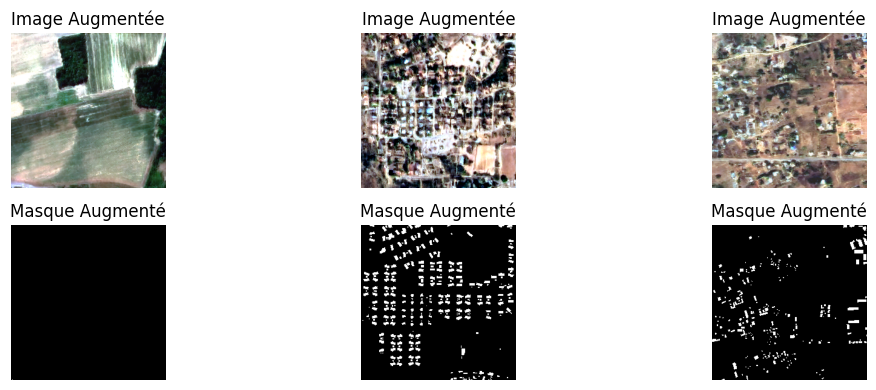

In [7]:
import tensorflow as tf

def augment_pair(x, y):
    """
    Augmentation de données pour les images satellites :
    Les rotations et flips sont parfaits car les bâtiments n'ont pas de sens 'haut/bas' fixe.
    """
    # Flips aléatoires
    if tf.random.uniform(()) > 0.5:
        x = tf.image.flip_left_right(x)
        y = tf.image.flip_left_right(y)
    if tf.random.uniform(()) > 0.5:
        x = tf.image.flip_up_down(x)
        y = tf.image.flip_up_down(y)

    # Rotations aléatoires par pas de 90 degrés
    k = tf.random.uniform((), minval=0, maxval=4, dtype=tf.int32)
    x = tf.image.rot90(x, k)
    y = tf.image.rot90(y, k)

    # Jitter photométrique (uniquement sur l'image, pas sur le masque !)
    x = tf.image.random_brightness(x, max_delta=0.1)
    x = tf.image.random_contrast(x, lower=0.8, upper=1.2)
    x = tf.clip_by_value(x, 0.0, 1.0)

    return x, y

def make_dataset(X, Y, batch_size, training=True):
    """
    Crée un pipeline de données TensorFlow optimisé.
    """
    ds = tf.data.Dataset.from_tensor_slices((X, Y))
    
    if training:
        # Mélange et augmentation pour l'entraînement
        ds = ds.shuffle(len(X), seed=SEED, reshuffle_each_iteration=True)
        ds = ds.map(augment_pair, num_parallel_calls=tf.data.AUTOTUNE)
    
    # Batching et prefetch (permet au CPU de préparer le prochain batch pendant que le GPU calcule)
    ds = ds.batch(batch_size).prefetch(tf.data.AUTOTUNE)
    return ds

# Création des datasets finaux
train_ds = make_dataset(X_train, Y_train, BATCH_SIZE, training=True)
val_ds = make_dataset(X_val, Y_val, BATCH_SIZE, training=False)

print(f"✅ Datasets prêts pour l'entraînement sur Kaggle")
print(f"📦 Taille du batch : {BATCH_SIZE}")

# --- VISUALISATION DES AUGMENTATIONS ---
# On récupère un exemple pour vérifier que l'image et le masque pivotent ensemble
plt.figure(figsize=(12, 4))
for imgs, msks in train_ds.take(1):
    for i in range(3):
        plt.subplot(2, 3, i+1)
        plt.imshow(imgs[i])
        plt.title("Image Augmentée")
        plt.axis("off")
        
        plt.subplot(2, 3, i+4)
        plt.imshow(msks[i].numpy().squeeze(), cmap='gray')
        plt.title("Masque Augmenté")
        plt.axis("off")
plt.tight_layout()
plt.show()

Image 1/15: sr7.tif | Couverture bâtiments: 6.24%
Image 2/15: sr3.tif | Couverture bâtiments: 24.28%
Image 3/15: sr4.tif | Couverture bâtiments: 1.13%
Image 4/15: sr10.tif | Couverture bâtiments: 10.47%
Image 5/15: sr19.tif | Couverture bâtiments: 6.52%
Image 6/15: sr5.tif | Couverture bâtiments: 2.20%
Image 7/15: sr11.tif | Couverture bâtiments: 5.90%
Image 8/15: sr2.tif | Couverture bâtiments: 3.31%
Image 9/15: sr12.tif | Couverture bâtiments: 3.71%
Image 10/15: sr23.tif | Couverture bâtiments: 8.49%
Image 11/15: sr13.tif | Couverture bâtiments: 7.75%
Image 12/15: sr1.tif | Couverture bâtiments: 4.43%
Image 13/15: sr6.tif | Couverture bâtiments: 14.56%
Image 14/15: sr22.tif | Couverture bâtiments: 2.88%
Image 15/15: sr14.tif | Couverture bâtiments: 4.95%


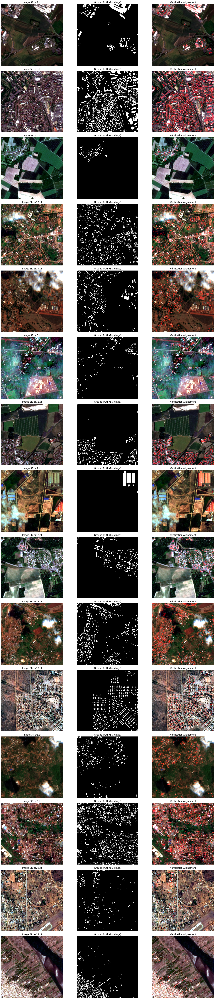

In [8]:
import numpy as np
import matplotlib.pyplot as plt

def visualize_entire_dataset(imgs, masks, metadata):
    num_images = len(imgs)
    # On crée une figure avec 3 colonnes : Image SR, Masque Binaire, Superposition (Overlay)
    fig, axes = plt.subplots(num_images, 3, figsize=(18, 5 * num_images))
    
    # Si il n'y a qu'une image, axes n'est pas une matrice 2D, on l'ajuste
    if num_images == 1:
        axes = np.expand_dims(axes, axis=0)

    for i in range(num_images):
        img = imgs[i]
        mask = masks[i]
        name = metadata[i]['name']
        
        # 1. Image SR (RGB)
        axes[i, 0].imshow(img)
        axes[i, 0].set_title(f"Image SR: {name}")
        axes[i, 0].axis("off")
        
        # 2. Masque Binaire (Empreintes OSM/Overture)
        axes[i, 1].imshow(mask, cmap="gray")
        axes[i, 1].set_title("Ground Truth (Buildings)")
        axes[i, 1].axis("off")
        
        # 3. Overlay (Superposition)
        # On crée un calque rouge pour les bâtiments
        overlay = img.copy()
        # On ajoute du rouge (canal 0) là où le masque est présent
        overlay[mask > 0, 0] = np.clip(overlay[mask > 0, 0] + 0.5, 0, 1) 
        
        axes[i, 2].imshow(overlay)
        axes[i, 2].set_title("Vérification Alignement")
        axes[i, 2].axis("off")
        
        # Calcul de la couverture pour info
        cov = 100.0 * mask.mean()
        print(f"Image {i+1}/{num_images}: {name} | Couverture bâtiments: {cov:.2f}%")

    plt.tight_layout()
    plt.show()

# --- EXÉCUTION ---
if len(images_list) > 0:
    visualize_entire_dataset(images_list, masks_list, file_metadata)
else:
    print("❌ Aucune image n'a été chargée. Vérifie le bloc précédent.")

In [9]:
import tensorflow as tf
from tensorflow.keras import layers, Model

# --- KAGGLE ADAPTATION: MULTI-GPU STRATEGY ---
# This detects both Tesla T4 GPUs and prepares the model to run on both simultaneously
strategy = tf.distribute.MirroredStrategy()
print(f"Number of devices: {strategy.num_replicas_in_sync}")

def conv_block(x, filters, dropout=0.0):
    x = layers.Conv2D(filters, 3, padding="same", use_bias=False)(x)
    x = layers.BatchNormalization()(x)
    x = layers.Activation("relu")(x)

    x = layers.Conv2D(filters, 3, padding="same", use_bias=False)(x)
    x = layers.BatchNormalization()(x)
    x = layers.Activation("relu")(x)

    if dropout > 0:
        x = layers.Dropout(dropout)(x)
    return x

def build_unet(input_shape=(256,256,3), base=32):
    inp = layers.Input(shape=input_shape)

    # Encoder (Downsampling)
    c1 = conv_block(inp, base, dropout=0.0)
    p1 = layers.MaxPool2D()(c1)

    c2 = conv_block(p1, base*2, dropout=0.0)
    p2 = layers.MaxPool2D()(c2)

    c3 = conv_block(p2, base*4, dropout=0.1)
    p3 = layers.MaxPool2D()(c3)

    c4 = conv_block(p3, base*8, dropout=0.2)
    p4 = layers.MaxPool2D()(c4)

    # Bridge
    b  = conv_block(p4, base*16, dropout=0.3)

    # Decoder (Upsampling)
    u4 = layers.UpSampling2D()(b)
    u4 = layers.Concatenate()([u4, c4])
    c5 = conv_block(u4, base*8, dropout=0.2)

    u3 = layers.UpSampling2D()(c5)
    u3 = layers.Concatenate()([u3, c3])
    c6 = conv_block(u3, base*4, dropout=0.1)

    u2 = layers.UpSampling2D()(c6)
    u2 = layers.Concatenate()([u2, c2])
    c7 = conv_block(u2, base*2, dropout=0.0)

    u1 = layers.UpSampling2D()(c7)
    u1 = layers.Concatenate()([u1, c1])
    c8 = conv_block(u1, base, dropout=0.0)

    out = layers.Conv2D(1, 1, activation="sigmoid")(c8)
    return Model(inp, out)

def dice_coef(y_true, y_pred, smooth=1e-6):
    y_true = tf.cast(y_true, tf.float32)
    y_pred = tf.cast(y_pred, tf.float32)
    y_true_f = tf.reshape(y_true, [-1])
    y_pred_f = tf.reshape(y_pred, [-1])
    inter = tf.reduce_sum(y_true_f * y_pred_f)
    denom = tf.reduce_sum(y_true_f) + tf.reduce_sum(y_pred_f)
    return (2. * inter + smooth) / (denom + smooth)

def bce_dice_loss(y_true, y_pred):
    # Standard Binary Cross Entropy
    bce = tf.keras.losses.BinaryCrossentropy()(y_true, y_pred)
    # Combine with Dice to handle class imbalance (buildings are small compared to background)
    return bce + (1.0 - dice_coef(y_true, y_pred))

# --- CREATE AND COMPILE MODEL UNDER STRATEGY ---
with strategy.scope():
    model = build_unet((PATCH_SIZE, PATCH_SIZE, 3), base=32)
    model.compile(
        optimizer=tf.keras.optimizers.Adam(learning_rate=LR),
        loss=bce_dice_loss,
        metrics=[
            tf.keras.metrics.BinaryAccuracy(name="acc"),
            tf.keras.metrics.BinaryIoU(threshold=0.5, name="iou"),
            dice_coef
        ]
    )

print("✅ Model built and compiled for Dual T4 GPU training.")
model.summary()

INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')
Number of devices: 2
✅ Model built and compiled for Dual T4 GPU training.


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d (Conv2D)     │ (None, 256, 256,  │        864 │ input_layer[0][0] │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalization │ (None, 256, 256,  │        128 │ conv2d[0][0]      │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation          │ (None, 256, 256,  │          0 │ batch_normalizat… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_1 (Conv2D)   │ (None, 256, 256,  │      9,216 │ activation[0][0]  │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 256, 256,  │        128 │ conv2d_1[0][0]    │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_1        │ (None, 256, 256,  │          0 │ batch_normalizat… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d       │ (None, 128, 128,  │          0 │ activation_1[0][… │
│ (MaxPooling2D)      │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_2 (Conv2D)   │ (None, 128, 128,  │     18,432 │ max_pooling2d[0]… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 128, 128,  │        256 │ conv2d_2[0][0]    │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_2        │ (None, 128, 128,  │          0 │ batch_normalizat… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_3 (Conv2D)   │ (None, 128, 128,  │     36,864 │ activation_2[0][… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 128, 128,  │        256 │ conv2d_3[0][0]    │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_3        │ (None, 128, 128,  │          0 │ batch_normalizat… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_1     │ (None, 64, 64,    │          0 │ activation_3[0][… │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_4 (Conv2D)   │ (None, 64, 64,    │     73,728 │ max_pooling2d_1[… │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 64, 64,    │        512 │ conv2d_4[0][0]  

 Total params: 7,855,489 (29.97 MB)

 Trainable params: 7,849,601 (29.94 MB)

 Non-trainable params: 5,888 (23.00 KB)

🚀 Début de l'entraînement sur 2 GPUs...
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task

E0000 00:00:1767640606.553890      55 meta_optimizer.cc:967] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inStatefulPartitionedCall/functional_1/dropout_1/stateless_dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer
I0000 00:00:1767640608.795568     135 cuda_dnn.cc:529] Loaded cuDNN version 91002
I0000 00:00:1767640608.795568     136 cuda_dnn.cc:529] Loaded cuDNN version 91002


176/176 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step - acc: 0.8411 - dice_coef: 0.2347 - iou: 0.5080 - loss: 1.9096
Epoch 1: val_loss improved from inf to 2.12089, saving model to /kaggle/working/outputs/unet_buildings.keras
176/176 ━━━━━━━━━━━━━━━━━━━━ 94s 414ms/step - acc: 0.8412 - dice_coef: 0.2349 - iou: 0.5081 - loss: 1.9090 - val_acc: 0.9176 - val_dice_coef: 0.0913 - val_iou: 0.4588 - val_loss: 2.1209 - learning_rate: 1.0000e-04
Epoch 2/40
176/176 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step - acc: 0.8695 - dice_coef: 0.3211 - iou: 0.5592 - loss: 1.6565
Epoch 2: val_loss did not improve from 2.12089
176/176 ━━━━━━━━━━━━━━━━━━━━ 72s 393ms/step - acc: 0.8695 - dice_coef: 0.3212 - iou: 0.5592 - loss: 1.6563 - val_acc: 0.9176 - val_dice_coef: 0.0644 - val_iou: 0.4588 - val_loss: 2.1979 - learning_rate: 1.0000e-04
Epoch 3/40
176/176 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step - acc: 0.8806 - dice_coef: 0.3543 - iou: 0.5745 - loss: 1.5655
Epoch 3: val_loss improved from 2.12089 to 1.51426, saving model to /kaggle/

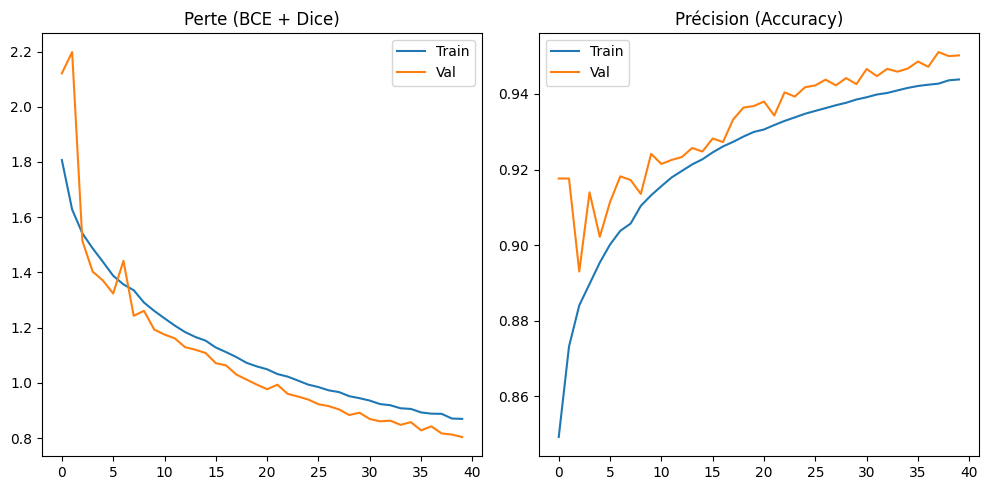


🔍 Optimisation du seuil de prédiction sur le set de validation...
45/45 ━━━━━━━━━━━━━━━━━━━━ 6s 99ms/step
   Threshold=0.200 -> F1=0.6963 | IoU=0.5341
   Threshold=0.250 -> F1=0.6989 | IoU=0.5372
   Threshold=0.300 -> F1=0.7008 | IoU=0.5394
   Threshold=0.350 -> F1=0.7022 | IoU=0.5411
   Threshold=0.400 -> F1=0.7031 | IoU=0.5422
   Threshold=0.450 -> F1=0.7037 | IoU=0.5428
   Threshold=0.500 -> F1=0.7040 | IoU=0.5432
   Threshold=0.550 -> F1=0.7040 | IoU=0.5432
   Threshold=0.600 -> F1=0.7036 | IoU=0.5427
   Threshold=0.650 -> F1=0.7028 | IoU=0.5418
   Threshold=0.700 -> F1=0.7015 | IoU=0.5402
   Threshold=0.750 -> F1=0.6994 | IoU=0.5378
   Threshold=0.800 -> F1=0.6962 | IoU=0.5339

✅ Meilleur seuil retenu : 0.500 (F1-Score=0.7040)


In [10]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf

# --- CALLBACKS POUR KAGGLE ---
# On s'assure que le modèle est sauvegardé dans l'espace de travail Kaggle (/kaggle/working/)
callbacks = [
    tf.keras.callbacks.ModelCheckpoint(MODEL_PATH, save_best_only=True, monitor="val_loss", mode="min", verbose=1),
    tf.keras.callbacks.EarlyStopping(patience=10, restore_best_weights=True, monitor="val_loss", verbose=1),
    tf.keras.callbacks.ReduceLROnPlateau(patience=4, factor=0.5, min_lr=1e-6, monitor="val_loss", verbose=1)
]

print(f"🚀 Début de l'entraînement sur {strategy.num_replicas_in_sync} GPUs...")

# --- ENTRAÎNEMENT ---
# MirroredStrategy gère automatiquement la distribution sur les 2 T4
history = model.fit(
    train_ds,
    validation_data=val_ds,
    epochs=EPOCHS,
    callbacks=callbacks,
    verbose=1
)

# --- VISUALISATION DES COURBES ---
plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
plt.plot(history.history["loss"], label="Train")
plt.plot(history.history["val_loss"], label="Val")
plt.title("Perte (BCE + Dice)")
plt.legend()

plt.subplot(1,2,2)
plt.plot(history.history["acc"], label="Train")
plt.plot(history.history.get("val_acc", history.history.get("val_binary_accuracy", [])), label="Val")
plt.title("Précision (Accuracy)")
plt.legend()
plt.tight_layout()
plt.show()

# --- FONCTION DE MÉTRIQUES ---
def compute_metrics_binary(y_true, y_pred_bin):
    # On aplatit les données pour un calcul global
    y_true = (y_true > 0.5).astype(np.uint8).reshape(-1)
    y_pred = (y_pred_bin > 0).astype(np.uint8).reshape(-1)

    tp = np.sum((y_true==1) & (y_pred==1))
    fp = np.sum((y_true==0) & (y_pred==1))
    fn = np.sum((y_true==1) & (y_pred==0))
    tn = np.sum((y_true==0) & (y_pred==0))

    precision = tp / (tp + fp + 1e-8)
    recall    = tp / (tp + fn + 1e-8)
    f1        = 2*precision*recall / (precision + recall + 1e-8)
    iou       = tp / (tp + fp + fn + 1e-8)
    dice      = (2*tp) / (2*tp + fp + fn + 1e-8)
    
    return dict(tp=tp, fp=fp, fn=fn, tn=tn, precision=precision, recall=recall, f1=f1, iou=iou, dice=dice)

# --- OPTIMISATION DU SEUIL (THRESHOLD TUNING) ---
print("\n🔍 Optimisation du seuil de prédiction sur le set de validation...")
# On prédit les probabilités sur les patches de validation
val_probs = model.predict(X_val, batch_size=BATCH_SIZE, verbose=1)

best_t, best_f1 = 0.5, -1
# On teste 13 seuils différents entre 0.2 et 0.8
for t in np.linspace(0.2, 0.8, 13):
    m = compute_metrics_binary(Y_val, (val_probs > t).astype(np.uint8))
    print(f"   Threshold={t:.3f} -> F1={m['f1']:.4f} | IoU={m['iou']:.4f}")
    if m["f1"] > best_f1:
        best_f1, best_t = m["f1"], t

PRED_THRESHOLD = float(best_t)
print(f"\n✅ Meilleur seuil retenu : {PRED_THRESHOLD:.3f} (F1-Score={best_f1:.4f})")

🔄 Reprise de l'entraînement pour 40 époques supplémentaires...
Epoch 1/40
176/176 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step - acc: 0.9430 - dice_coef: 0.6533 - iou: 0.7267 - loss: 0.8740
Epoch 1: val_loss did not improve from 0.80416
176/176 ━━━━━━━━━━━━━━━━━━━━ 73s 399ms/step - acc: 0.9430 - dice_coef: 0.6533 - iou: 0.7267 - loss: 0.8739 - val_acc: 0.9499 - val_dice_coef: 0.6756 - val_iou: 0.7450 - val_loss: 0.8055 - learning_rate: 1.0000e-04
Epoch 2/40
176/176 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step - acc: 0.9437 - dice_coef: 0.6540 - iou: 0.7280 - loss: 0.8707
Epoch 2: val_loss improved from 0.80416 to 0.79813, saving model to /kaggle/working/outputs/unet_buildings.keras
176/176 ━━━━━━━━━━━━━━━━━━━━ 73s 399ms/step - acc: 0.9437 - dice_coef: 0.6540 - iou: 0.7280 - loss: 0.8706 - val_acc: 0.9509 - val_dice_coef: 0.6798 - val_iou: 0.7469 - val_loss: 0.7981 - learning_rate: 1.0000e-04
Epoch 3/40
176/176 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step - acc: 0.9433 - dice_coef: 0.6614 - iou: 0.7317 - loss: 0.856

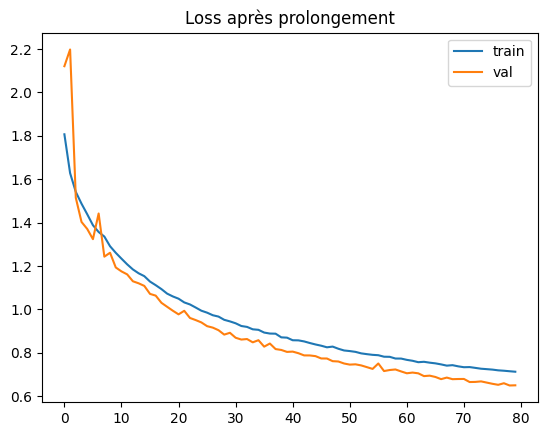

In [11]:
# On augmente le nombre d'époques
EXTRA_EPOCHS = 40

print(f"🔄 Reprise de l'entraînement pour {EXTRA_EPOCHS} époques supplémentaires...")

history_extra = model.fit(
    train_ds,
    validation_data=val_ds,
    epochs=EXTRA_EPOCHS,
    callbacks=callbacks # Les mêmes callbacks (EarlyStopping s'arrêtera s'il n'y a plus de progrès)
)

# Fusionner les historiques pour voir la courbe complète si tu veux
for key in history.history:
    history.history[key].extend(history_extra.history[key])

# Afficher la nouvelle courbe de perte
plt.plot(history.history["loss"], label="train")
plt.plot(history.history["val_loss"], label="val")
plt.title("Loss après prolongement")
plt.legend()
plt.show()

🔄 Reprise de l'entraînement pour 20 époques supplémentaires...
Epoch 1/20
176/176 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step - acc: 0.9536 - dice_coef: 0.7143 - iou: 0.7658 - loss: 0.7264
Epoch 1: val_loss improved from 0.64941 to 0.64813, saving model to /kaggle/working/outputs/unet_buildings.keras
176/176 ━━━━━━━━━━━━━━━━━━━━ 74s 404ms/step - acc: 0.9536 - dice_coef: 0.7143 - iou: 0.7658 - loss: 0.7263 - val_acc: 0.9613 - val_dice_coef: 0.7412 - val_iou: 0.7884 - val_loss: 0.6481 - learning_rate: 1.0000e-04
Epoch 2/20
176/176 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step - acc: 0.9562 - dice_coef: 0.7211 - iou: 0.7717 - loss: 0.7050
Epoch 2: val_loss improved from 0.64813 to 0.64812, saving model to /kaggle/working/outputs/unet_buildings.keras
176/176 ━━━━━━━━━━━━━━━━━━━━ 73s 399ms/step - acc: 0.9562 - dice_coef: 0.7211 - iou: 0.7717 - loss: 0.7051 - val_acc: 0.9603 - val_dice_coef: 0.7434 - val_iou: 0.7877 - val_loss: 0.6481 - learning_rate: 1.0000e-04
Epoch 3/20
176/176 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/

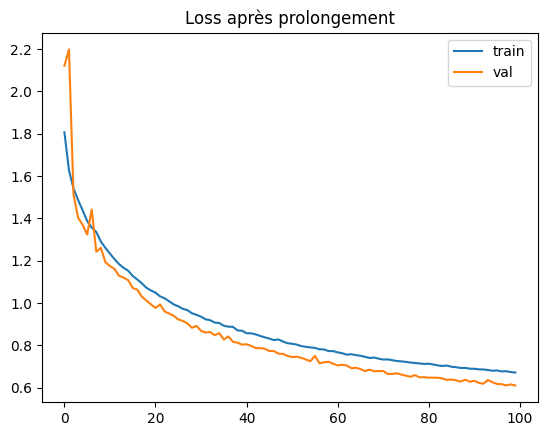

In [12]:
# On augmente le nombre d'époques
EXTRA_EPOCHS = 20

print(f"🔄 Reprise de l'entraînement pour {EXTRA_EPOCHS} époques supplémentaires...")

history_extra = model.fit(
    train_ds,
    validation_data=val_ds,
    epochs=EXTRA_EPOCHS,
    callbacks=callbacks # Les mêmes callbacks (EarlyStopping s'arrêtera s'il n'y a plus de progrès)
)

# Fusionner les historiques pour voir la courbe complète si tu veux
for key in history.history:
    history.history[key].extend(history_extra.history[key])

# Afficher la nouvelle courbe de perte
plt.plot(history.history["loss"], label="train")
plt.plot(history.history["val_loss"], label="val")
plt.title("Loss après prolongement")
plt.legend()
plt.show()

🔄 Reprise de l'entraînement pour 50 époques supplémentaires...
Epoch 1/50
176/176 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step - acc: 0.9578 - dice_coef: 0.7359 - iou: 0.7810 - loss: 0.6715
Epoch 1: val_loss improved from 0.61108 to 0.60658, saving model to /kaggle/working/outputs/unet_buildings.keras
176/176 ━━━━━━━━━━━━━━━━━━━━ 73s 403ms/step - acc: 0.9578 - dice_coef: 0.7359 - iou: 0.7810 - loss: 0.6715 - val_acc: 0.9642 - val_dice_coef: 0.7579 - val_iou: 0.8005 - val_loss: 0.6066 - learning_rate: 1.0000e-04
Epoch 2/50
176/176 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step - acc: 0.9573 - dice_coef: 0.7364 - iou: 0.7812 - loss: 0.6716
Epoch 2: val_loss did not improve from 0.60658
176/176 ━━━━━━━━━━━━━━━━━━━━ 72s 395ms/step - acc: 0.9573 - dice_coef: 0.7364 - iou: 0.7812 - loss: 0.6715 - val_acc: 0.9643 - val_dice_coef: 0.7563 - val_iou: 0.8004 - val_loss: 0.6075 - learning_rate: 1.0000e-04
Epoch 3/50
176/176 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step - acc: 0.9587 - dice_coef: 0.7384 - iou: 0.7839 - loss: 0.664

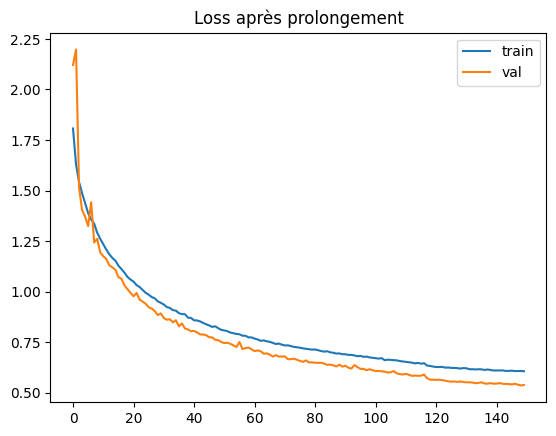

In [13]:
# On augmente le nombre d'époques
EXTRA_EPOCHS = 50

print(f"🔄 Reprise de l'entraînement pour {EXTRA_EPOCHS} époques supplémentaires...")

history_extra = model.fit(
    train_ds,
    validation_data=val_ds,
    epochs=EXTRA_EPOCHS,
    callbacks=callbacks # Les mêmes callbacks (EarlyStopping s'arrêtera s'il n'y a plus de progrès)
)

# Fusionner les historiques pour voir la courbe complète si tu veux
for key in history.history:
    history.history[key].extend(history_extra.history[key])

# Afficher la nouvelle courbe de perte
plt.plot(history.history["loss"], label="train")
plt.plot(history.history["val_loss"], label="val")
plt.title("Loss après prolongement")
plt.legend()
plt.show()

✅ Carte de probabilité générée : (512, 512)


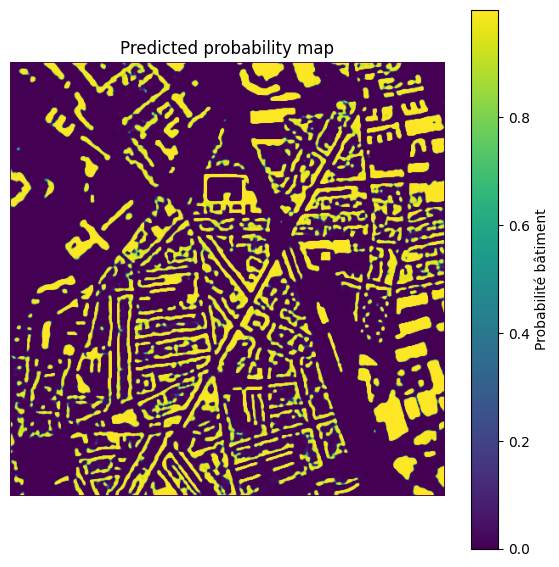

In [14]:
def hann2d(h, w):
    wy = np.hanning(h)
    wx = np.hanning(w)
    return np.outer(wy, wx).astype(np.float32)

def predict_full_image(model, img, tile=256, stride=128):
    H, W = img.shape[:2]
    pad_h = (tile - (H % stride)) % stride
    pad_w = (tile - (W % stride)) % stride

    img_pad = np.pad(img, ((0,pad_h),(0,pad_w),(0,0)), mode="reflect")
    Hp, Wp = img_pad.shape[:2]

    weight = hann2d(tile, tile)
    prob_sum = np.zeros((Hp, Wp), dtype=np.float32)
    w_sum = np.zeros((Hp, Wp), dtype=np.float32)

    ys = list(range(0, Hp - tile + 1, stride))
    xs = list(range(0, Wp - tile + 1, stride))
    if ys[-1] != Hp - tile: ys.append(Hp - tile)
    if xs[-1] != Wp - tile: xs.append(Wp - tile)

    for y0 in ys:
        for x0 in xs:
            patch = img_pad[y0:y0+tile, x0:x0+tile]
            # Inférence
            pred = model.predict(patch[None,...], verbose=0)[0,...,0]
            prob_sum[y0:y0+tile, x0:x0+tile] += pred * weight
            w_sum[y0:y0+tile, x0:x0+tile] += weight

    prob = prob_sum / (w_sum + 1e-8)
    return prob[:H, :W]

# --- KAGGLE : Inférence sur une image test ---
# On choisit la première image du set de validation pour l'exemple
test_img = images_list[1]
prob_map = predict_full_image(model, test_img, tile=PATCH_SIZE, stride=STRIDE)

print(f"✅ Carte de probabilité générée : {prob_map.shape}")
plt.figure(figsize=(7,7))
plt.imshow(prob_map, cmap="viridis")
plt.title("Predicted probability map")
plt.colorbar(label="Probabilité bâtiment")
plt.axis("off")
plt.show()

In [15]:
from scipy import ndimage as ndi
from skimage.feature import peak_local_max
from skimage.segmentation import watershed
from skimage.morphology import remove_small_objects, remove_small_holes

def postprocess(prob, threshold, min_obj=40, hole_size=80, use_watershed=True, min_distance=6):
    """
    Nettoie la carte de probabilité du U-Net :
    1. Binarisation avec le seuil optimisé.
    2. Suppression des petits bruits (pixels isolés).
    3. Remplissage des petits trous à l'intérieur des toits.
    4. Séparation des bâtiments collés (Watershed).
    """
    # 1. Seuil (Thresholding)
    binm = (prob >= threshold)
    
    # 2. Nettoyage morphologique
    # Supprime les objets plus petits que min_obj pixels
    binm = remove_small_objects(binm, min_size=min_obj)
    # Remplit les trous à l'intérieur des bâtiments (ex: cheminées ou zones d'ombre)
    binm = remove_small_holes(binm, area_threshold=hole_size)
    
    binm_u8 = binm.astype(np.uint8)

    if not use_watershed:
        return binm_u8

    # 3. Algorithme de la ligne de partage des eaux (Watershed)
    # Utile pour séparer deux maisons qui se touchent
    dist = ndi.distance_transform_edt(binm_u8) # Carte des distances au bord
    # Trouve les centres des toits
    peaks = peak_local_max(dist, min_distance=min_distance, labels=binm_u8)
    
    markers = np.zeros_like(binm_u8, dtype=np.int32)
    for i, (r, c) in enumerate(peaks, start=1):
        markers[r, c] = i
        
    if markers.max() < 2: # S'il n'y a qu'un seul bâtiment, pas besoin de split
        return binm_u8
    
    # On "inonde" à partir des centres pour séparer les formes
    labels = watershed(-dist, markers, mask=binm_u8)
    out = (labels > 0).astype(np.uint8)
    
    # Nettoyage final
    out = remove_small_objects(out.astype(bool), min_size=min_obj).astype(np.uint8)
    
    return out

print("✅ Fonction postprocess définie et prête.")

✅ Fonction postprocess définie et prête.


In [16]:
from rasterio import features

# 1. Appliquer le post-traitement (nettoyage morphologique)
pred_mask = postprocess(
    prob_map, 
    threshold=PRED_THRESHOLD, 
    min_obj=MIN_OBJECT_PIXELS, 
    hole_size=HOLE_PIXELS, 
    use_watershed=USE_WATERSHED_SPLIT, 
    min_distance=WATERSHED_MIN_DISTANCE
)

# 2. Récupération dynamique du nom du fichier
# Au lieu de metadata_list, on utilise all_tif_files[0] car c'est l'image testée
current_tif_path = all_tif_files[0]
img_name = os.path.basename(current_tif_path).replace(".tif", "")

prob_tif = os.path.join(OUTPUT_DIR, f"{img_name}_prob.tif")
mask_tif = os.path.join(OUTPUT_DIR, f"{img_name}_mask.tif")

# 3. Sauvegarde des GeoTIFFs avec les métadonnées réelles
with rasterio.open(current_tif_path) as src:
    out_profile = src.profile.copy()
    out_transform = src.transform
    out_crs = src.crs

# Sauvegarde de la carte de probabilités (Float32)
out_profile.update(count=1, dtype="float32", nodata=0)
with rasterio.open(prob_tif, "w", **out_profile) as dst:
    dst.write(prob_map.astype(np.float32), 1)

# Sauvegarde du masque final binaire (Uint8)
out_profile.update(dtype="uint8")
with rasterio.open(mask_tif, "w", **out_profile) as dst:
    dst.write(pred_mask.astype(np.uint8), 1)

# 4. Vectorisation (GeoJSON) et Estimation Énergétique
shapes_gen = features.shapes(pred_mask.astype(np.uint8), transform=out_transform)
geoms = [shape(geom) for geom, val in shapes_gen if val == 1]
gdf = gpd.GeoDataFrame({"geometry": geoms}, crs=out_crs)

# Paramètres PV pour ton PFE (A ajuster selon ta région d'étude)
G_avg = 1500  # Irradiation (kWh/m2/an)
Eff = 0.20    # Rendement panneau (20%)
PR = 0.75     # Performance Ratio

try:
    # On reprojette en mètres (UTM) pour calculer l'aire réelle
    # On définit l'emprise pour trouver le bon fuseau UTM
    bbox = box(*src.bounds)
    west, south, east, north = bounds_to_wgs84(bbox.bounds, out_crs)
    utm_crs = estimate_utm_crs_from_bounds((west, south, east, north))
    
    gdf_m = gdf.to_crs(utm_crs)
    gdf["area_m2"] = gdf_m.area
    
    # Filtrage : On ne garde que les objets > 10m2 (vrais toits)
    gdf = gdf[gdf["area_m2"] > 10].copy()
    
    # Estimation PV : Surface * 70% (utilisable) * Irradiation * Rendement * PR
    gdf["yearly_energy_kwh"] = gdf["area_m2"] * 0.70 * G_avg * Eff * PR
    
    total_energy = gdf["yearly_energy_kwh"].sum()
    print(f"☀️ --- RÉSULTATS POUR L'IMAGE : {img_name} ---")
    print(f"🏠 Nombre de bâtiments détectés : {len(gdf)}")
    print(f"📐 Surface totale de toiture : {gdf['area_m2'].sum():.2f} m²")
    print(f"⚡ Production estimée du site : {total_energy/1000:.2f} MWh/an")
    
except Exception as e:
    print(f"⚠️ Erreur lors du calcul SIG : {e}")

# Sauvegarde du fichier SIG final pour QGIS
geojson_path = os.path.join(OUTPUT_DIR, f"{img_name}_results.geojson")
gdf.to_file(geojson_path, driver="GeoJSON")
print(f"✅ Fichiers sauvegardés dans : {OUTPUT_DIR}")

gdf.head()

⚠️ Erreur lors du calcul SIG : 'tuple' object has no attribute 'left'
✅ Fichiers sauvegardés dans : /kaggle/working/outputs


,geometry
0,"POLYGON ((448876.537 1743786.928, 448876.537 1..."
1,"POLYGON ((449431.537 1743786.928, 449431.537 1..."
2,"POLYGON ((449531.537 1743786.928, 449531.537 1..."
3,"POLYGON ((448446.537 1743769.428, 448446.537 1..."
4,"POLYGON ((449504.037 1743766.928, 449504.037 1..."


📊 RÉSULTATS SCIENTIFIQUES (IMAGE COMPLÈTE)
 precision: 0.8089
    recall: 0.8287
        f1: 0.8187
       iou: 0.6930
      dice: 0.8187


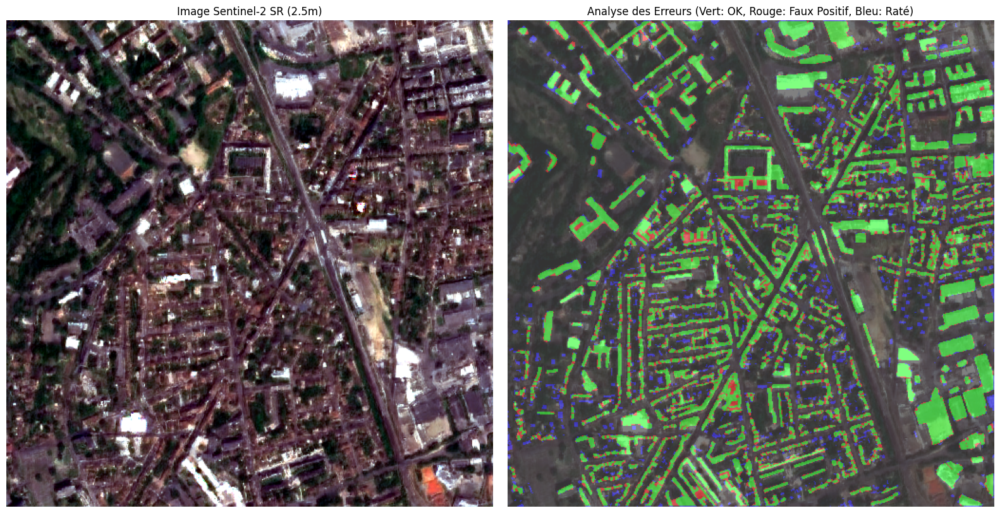

In [17]:
# On utilise le masque Ground Truth (vérité terrain) généré en cellule 5
gt_mask_test = masks_list[1] 

metrics_full = compute_metrics_binary(gt_mask_test[...,None], pred_mask[...,None])

print("📊 RÉSULTATS SCIENTIFIQUES (IMAGE COMPLÈTE)")
for k in ["precision","recall","f1","iou","dice"]:
    print(f"{k:>10}: {metrics_full[k]:.4f}")

# Carte d'erreurs (Visualisation pour ton rapport)
y_true = (gt_mask_test > 0)
y_pred = (pred_mask > 0)

# Couleurs : Vert = Juste (TP), Rouge = Trop (FP), Bleu = Raté (FN)
err = np.zeros((test_img.shape[0], test_img.shape[1], 3), dtype=np.uint8)
err[(y_true) & (y_pred)] = [0, 255, 0]   # TP Green
err[(~y_true) & (y_pred)] = [255, 0, 0]  # FP Red
err[(y_true) & (~y_pred)] = [0, 0, 255]  # FN Blue

plt.figure(figsize=(16,8))
plt.subplot(1,2,1)
plt.imshow(test_img)
plt.title("Image Sentinel-2 SR (2.5m)")
plt.axis("off")

plt.subplot(1,2,2)
plt.imshow(test_img, alpha=0.6)
plt.imshow(err, alpha=0.5)
plt.title("Analyse des Erreurs (Vert: OK, Rouge: Faux Positif, Bleu: Raté)")
plt.axis("off")

plt.tight_layout()
plt.savefig(os.path.join(OUTPUT_DIR, "error_map.png"))
plt.show()